### Примеры аугментаций, использовавшихся при обучении.

используемый датасет с двумя сэмплами по ссылке  https://kaggle.com/datasets/89e00569aa9c0f49721f0465c88d98f49f003e10869d3e4a6effb917e4248f1d


In [ ]:
!pip install audiomentations

In [13]:
from audiomentations import *
import librosa
import torch
import torchaudio
import numpy as np
import matplotlib.pyplot as plt

from IPython import display

In [4]:
def visualize_audio(wav: torch.Tensor, sr: int = 16000):
    # Average all channels
    if wav.dim() == 2:
        # Any to mono audio convertion
        wav = wav.mean(dim=0)
    
    plt.figure(figsize=(20, 5))
    plt.plot(wav, alpha=.7, c='green')
    plt.grid()
    plt.xlabel('Time', size=20)
    plt.ylabel('Amplitude', size=20)
    plt.show()
    
    display.display(display.Audio(wav, rate=sr))

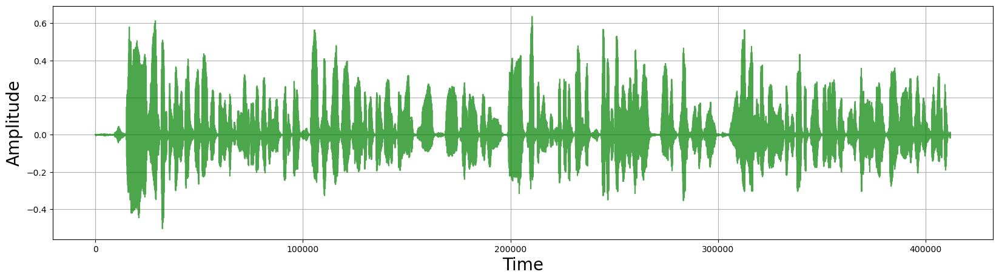

In [22]:
wav, sr = librosa.load(f"/kaggle/input/testing-augmentations/ajdofpyqqjrdmrkeknum.wav", sr=None, mono=True)
visualize_audio(torch.tensor(wav))

### Ускорение/замедление аудио

При обучении использую изменение скорости от 0.8 до 1.25. Параметр выбирается из равномерного распределения.

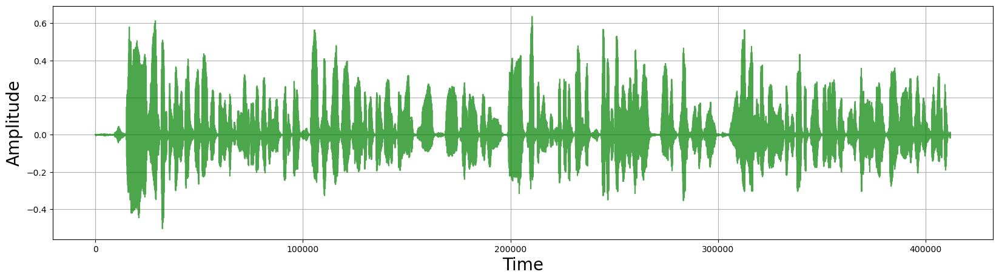

None



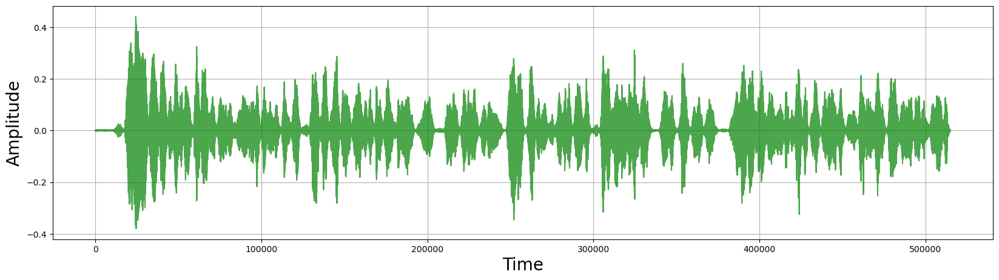

None


In [6]:
transform = TimeStretch(min_rate=0.8, max_rate=0.8, leave_length_unchanged=False, p=1)
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

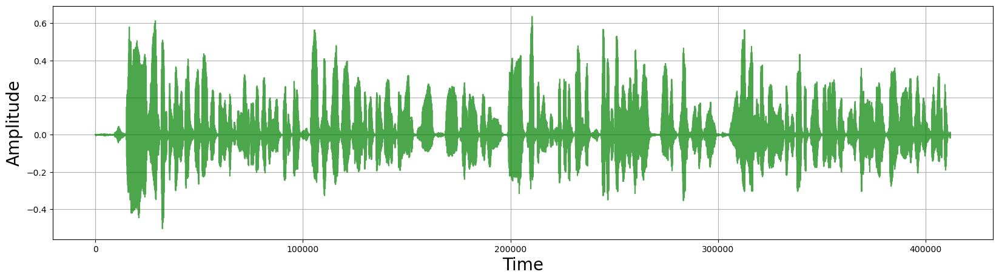

None



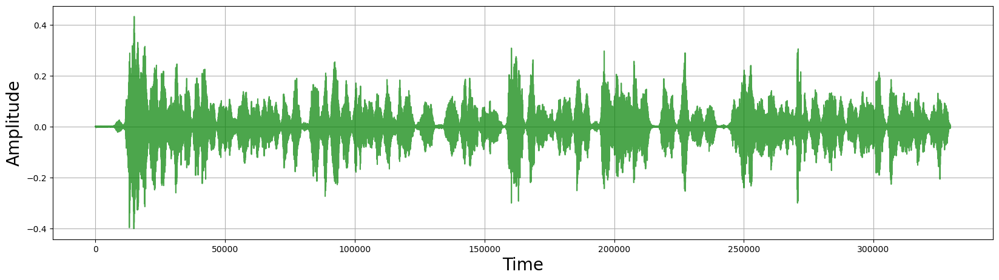

None


In [7]:
transform = TimeStretch(min_rate=1.25, max_rate=1.25, leave_length_unchanged=False, p=1)
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

### Наложение гаусовского шума (разновидность белого шума)

При обучении использую амплитуду от 0.001 до 0.015. Параметр выбирается из равномерного распределения.

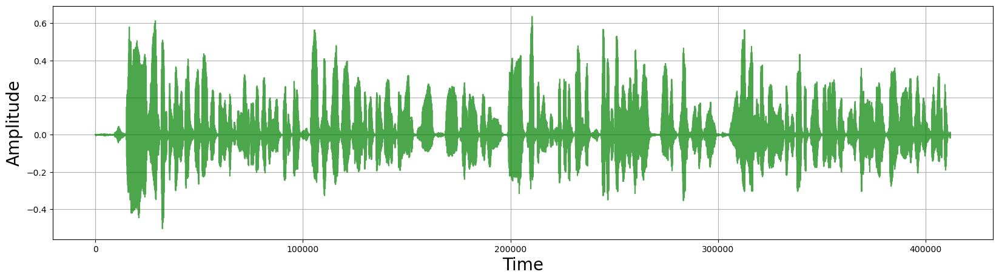

None



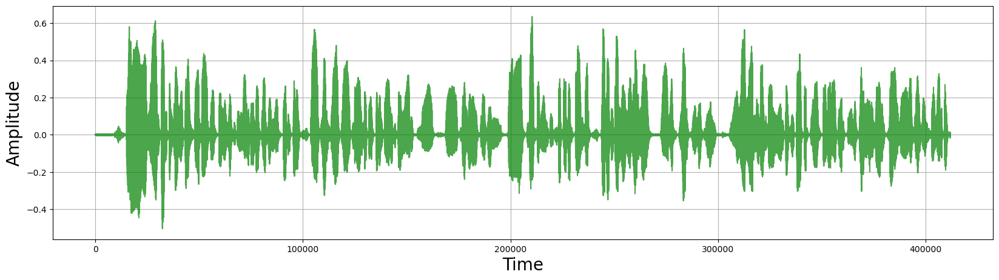

None


In [8]:
transform = AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.001, p=1)
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

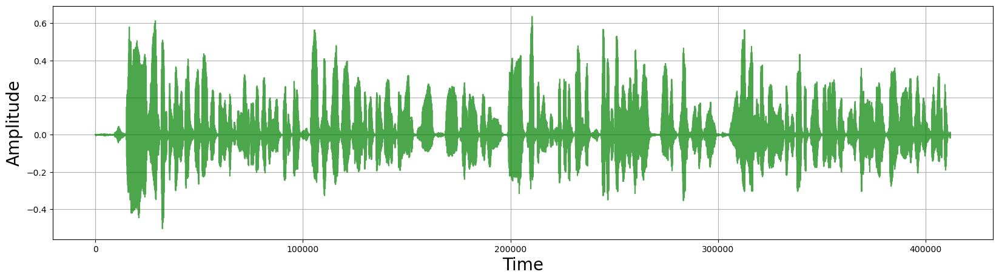

None



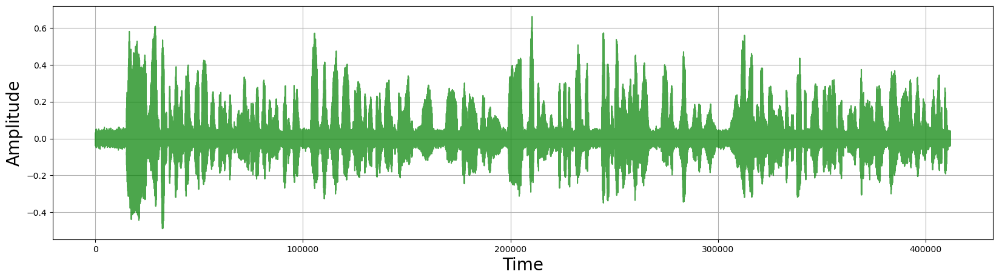

None


In [9]:
transform = AddGaussianNoise(min_amplitude=0.015, max_amplitude=0.015, p=1)
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

### Изменение громкости

Хотя у почему громкость при таком вопроизведении не меняется, амплитуда увеличивается/уменьшается
В ходе такого увеличения значения амплитуды могут выйти за пределы [-1,1], поэтому в конце необходимо применять Clip, который позволит этого избежать.

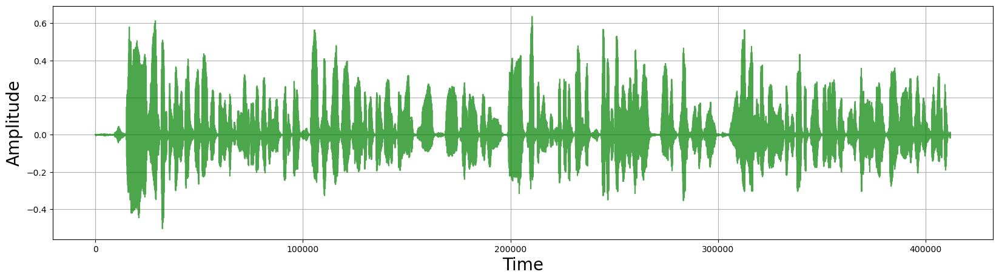

None



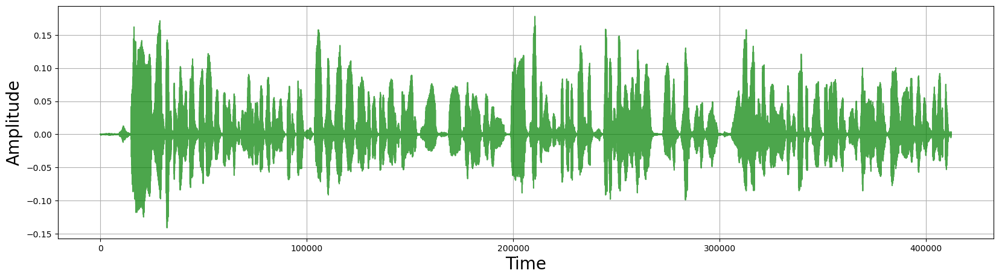

None


In [14]:
transform = Compose([Gain(p=1), Clip(p=1)])
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

### Time masking
Вырезает маленький кусочек аудио в случайном месте. К сожалению данная функция работает не так как нужно. Здесь необходимо задать длину вырезаемого куска в виде доли от общей длины. Но у меня в выборке есть аудио 3 сек и есть аудио 30 сек. Одинаковая вырезанная доля в них ощущается совсем по разному. В связи с этим данная функция должна быть доработана.

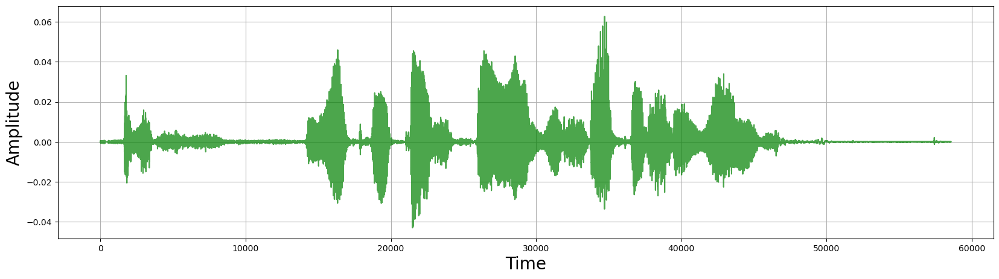

None



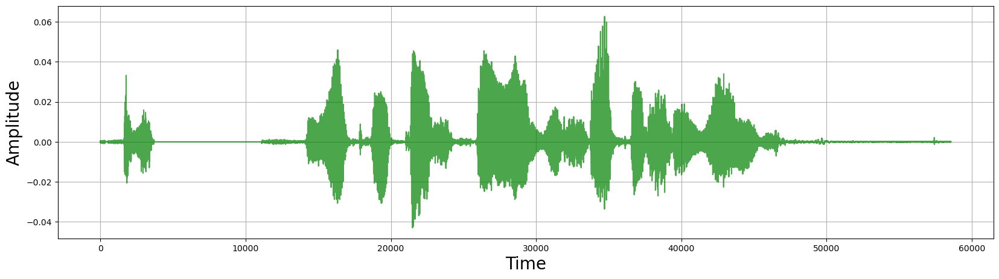

None


In [21]:
transform = TimeMask(min_band_part=0.01, max_band_part=0.02, fade=False, p=1.0)
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

### Pitch shifting (замена тембра)

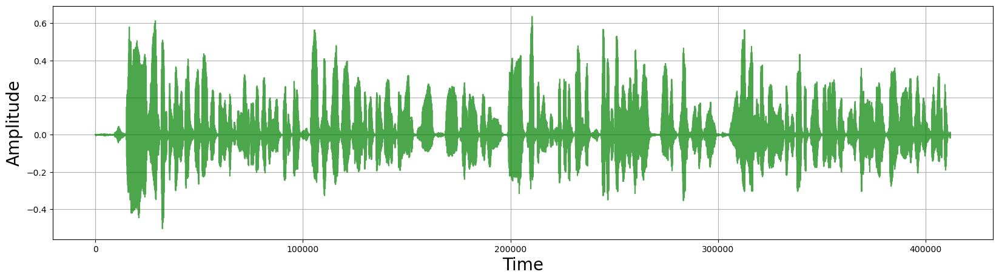

None



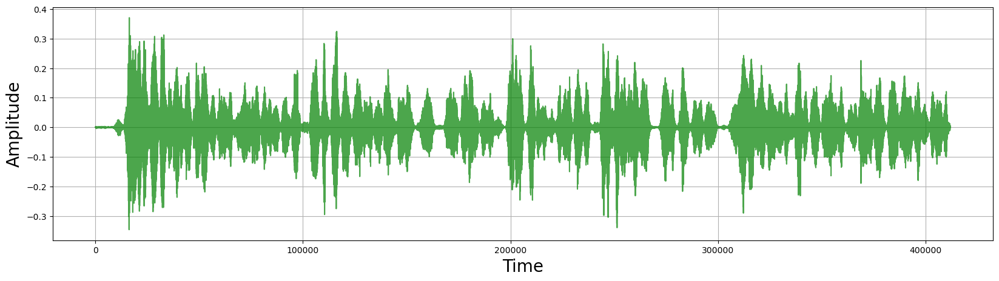

None



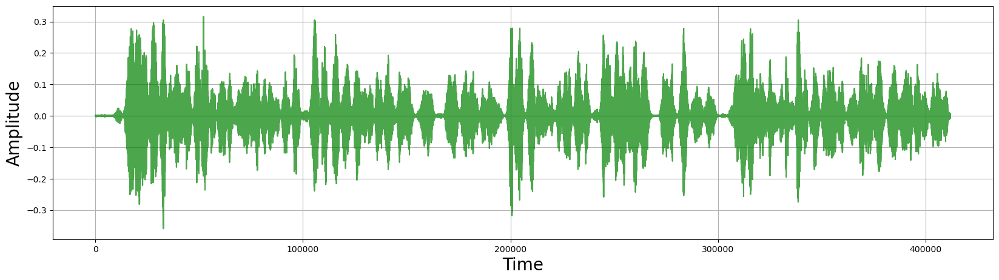

None



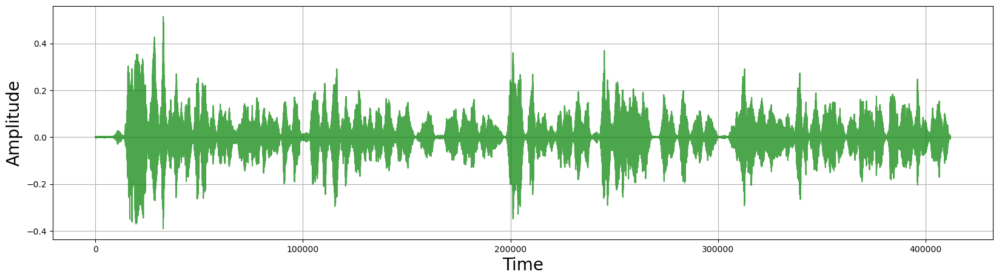

None



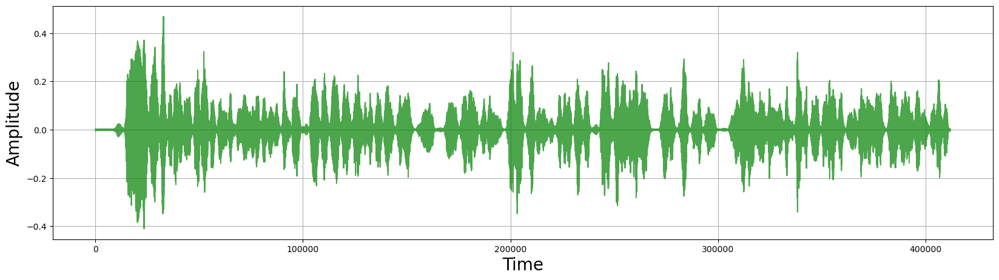

None



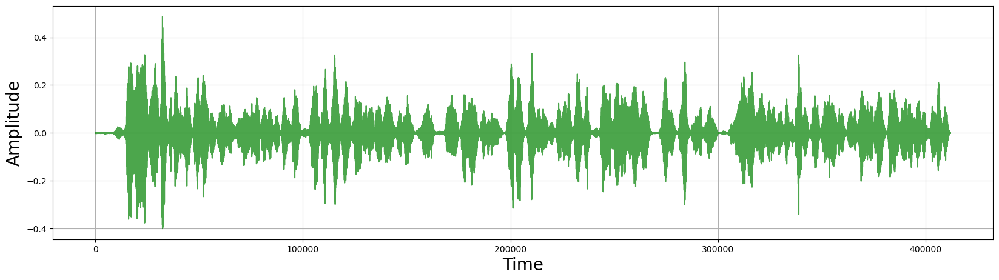

None


In [30]:
transform = PitchShift(p=1.0)
    
print(visualize_audio(torch.tensor(wav)))
for i in range(5):
    print()
    augmented_wav = transform(wav, sample_rate=16000)
    print(visualize_audio(torch.tensor(augmented_wav)))

### ApplyImpulseResponse (симуляция звуковых эффектов при записи в разных помещениях)

На основе датасета https://kaggle.com/datasets/2ff46dd8ee67d3d36367196da5d381ebfbf5ebb1b76d3049b0b1a7ff397d7fac

Оригинал датасета https://mcdermottlab.mit.edu/Reverb/IR_Survey.html

/opt/conda/lib/python3.10/site-packages/audiomentations/core/audio_loading_utils.py:34: UserWarning: /kaggle/input/impulseresponse-dataset/Audio/h013_Hospital_ExaminationRoom_19txts.wav had to be resampled from 32000 hz to 16000 hz. This hurt execution time.
  warnings.warn(


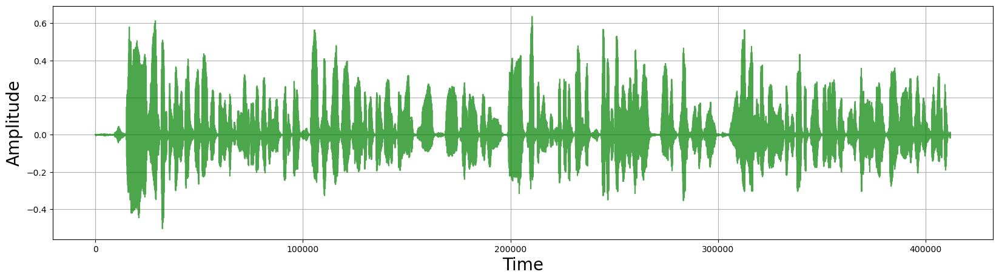

None



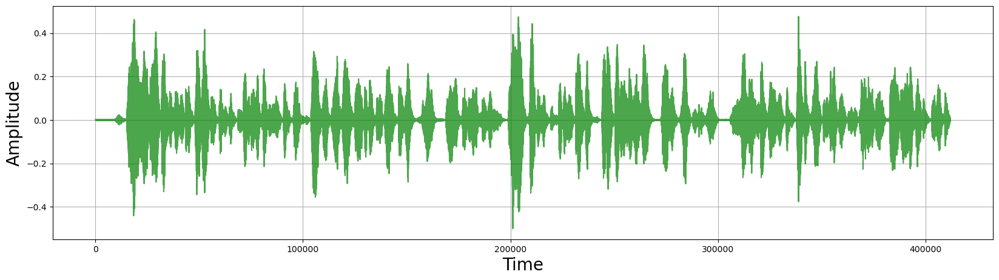

None


In [27]:
transform = ApplyImpulseResponse(ir_path='/kaggle/input/impulseresponse-dataset', p=1.0)    

augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(wav)))
print()
print(visualize_audio(torch.tensor(augmented_wav)))

# надо наверное создать копию с sr=16000 чтобы обучение по шустрее шло

###  BandPassFilter (полосовый фильтр)

средние частоты звучат в полную громкость, а верхние и нижние фильтруются
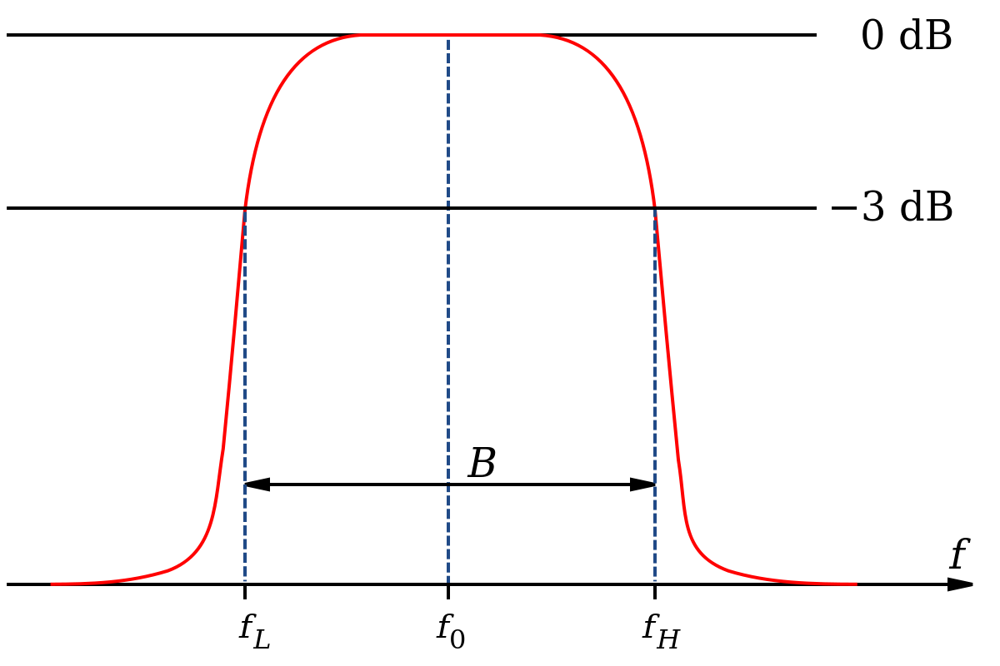


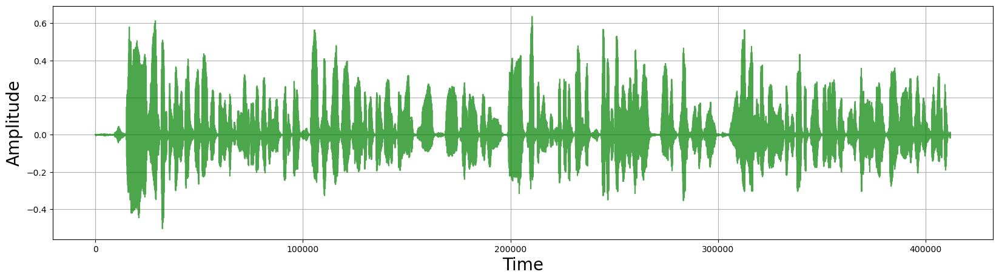

None



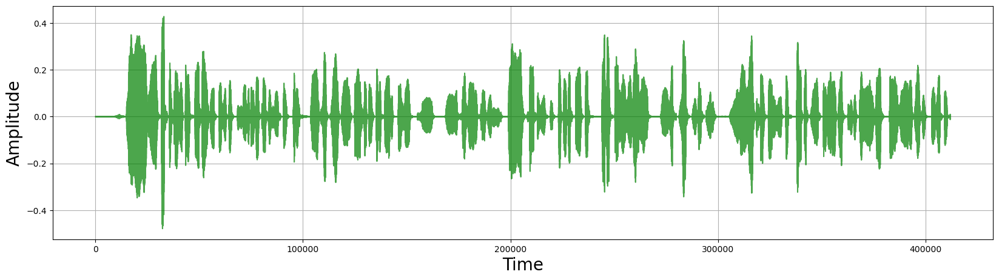

None



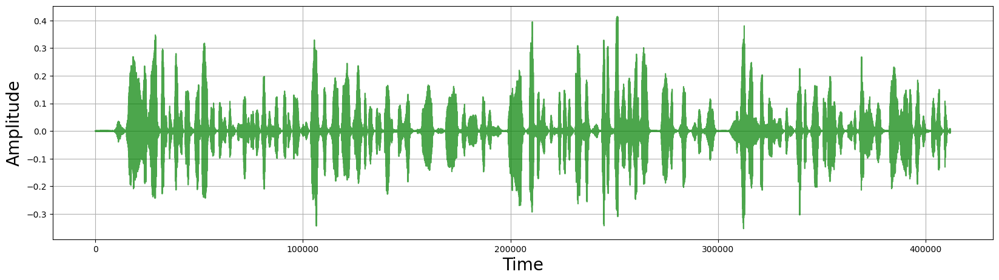

None



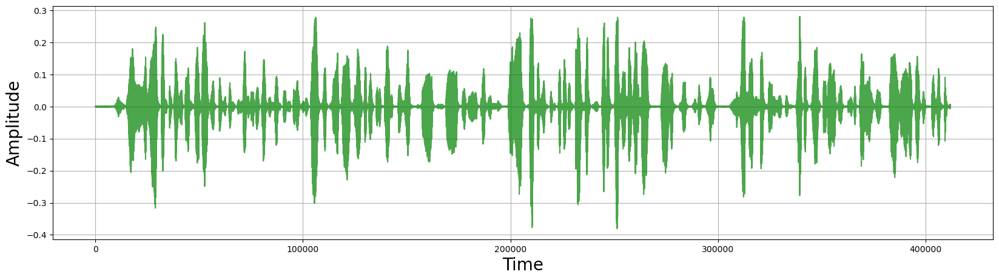

None



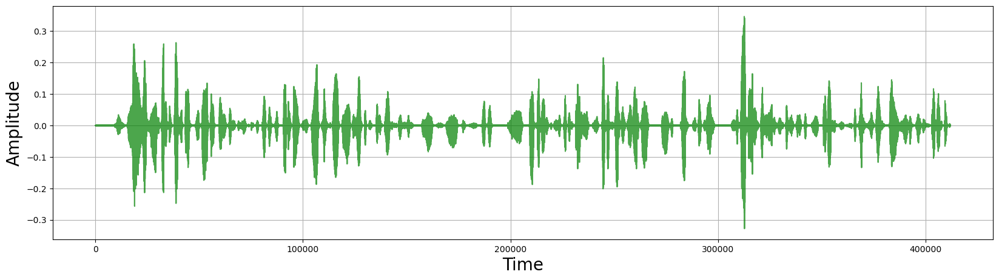

None



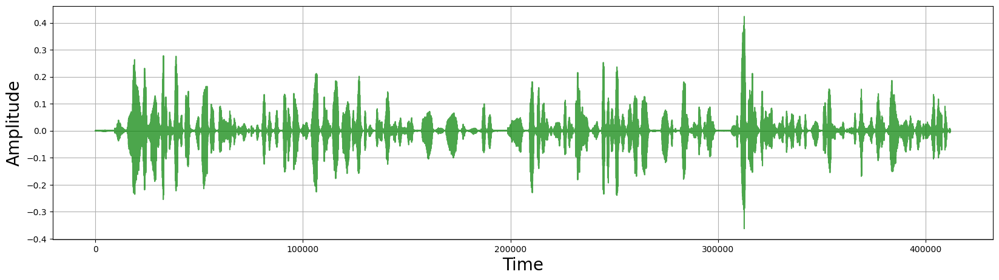

None


In [28]:
transform = BandPassFilter(p=1.0)
    
print(visualize_audio(torch.tensor(wav)))
for i in range(5):
    print()
    augmented_wav = transform(wav, sample_rate=16000)
    print(visualize_audio(torch.tensor(augmented_wav)))


### ClippingDistortion

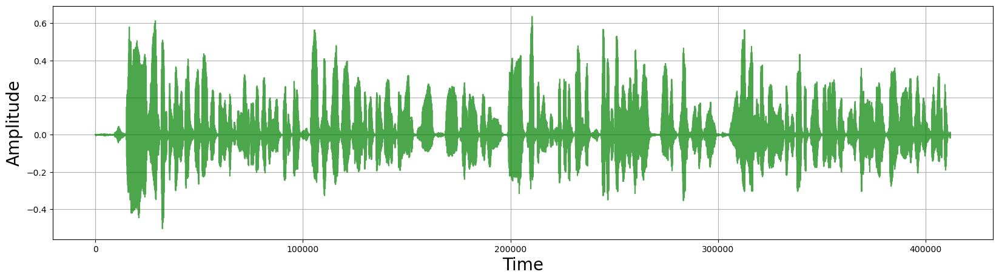

None


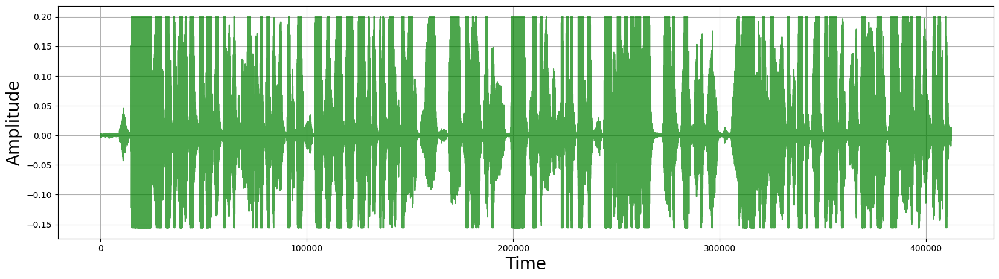

None


In [31]:
from audiomentations import ClippingDistortion
transform = ClippingDistortion(p=1.0)
    
print(visualize_audio(torch.tensor(wav)))
augmented_wav = transform(wav, sample_rate=16000)
print(visualize_audio(torch.tensor(augmented_wav)))